In [1]:
import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator
import numpy as np
import plotly.express as px
plt.style.use('ggplot')
import sys 
sys.path.append('..')
from utils.dataloader import load_data, create_count_data

## Data Loading

In [3]:
df = load_data()
df.head()

,Station Name,MAC Address,Start Date,End Date,Energy (kWh),Port Type,Port Number,Plug Type,Latitude,Longitude,Fee,Plug In Event Id,Id,Total Duration (min),Charging Time (min),Cluster
0,PALO ALTO CA / HAMILTON #1,000D:6F00:015A:9D76,2011-07-29 20:17:00,2011-07-29 23:20:00,6.249457,Level 2,2,J1772,37.444572,-122.160309,0.0,3,0,183.533333,114.050000,HAMILTON
1,PALO ALTO CA / HAMILTON #1,000D:6F00:015A:9D76,2011-07-30 00:00:00,2011-07-30 00:02:00,0.106588,Level 2,2,J1772,37.444572,-122.160309,0.0,4,1,2.100000,1.900000,HAMILTON
2,PALO ALTO CA / HAMILTON #1,000D:6F00:015A:9D76,2011-07-30 08:16:00,2011-07-30 12:34:00,14.951777,Level 2,2,J1772,37.444572,-122.160309,0.0,5,2,257.533333,257.466667,HAMILTON
3,PALO ALTO CA / HAMILTON #1,000D:6F00:015A:9D76,2011-07-30 14:51:00,2011-07-30 16:55:00,7.159643,Level 2,2,J1772,37.444572,-122.160309,0.0,6,3,123.400000,122.966667,HAMILTON
4,PALO ALTO CA / HAMILTON #1,000D:6F00:015A:9D76,2011-07-30 18:51:00,2011-07-30 20:03:00,1.957765,Level 2,2,J1772,37.444572,-122.160309,0.0,7,4,71.400000,43.900000,HAMILTON


## Data Visualization

In [4]:
# plot the geographical distribution of the charging stations
fig = px.scatter_mapbox(df, lat="Latitude", lon="Longitude", hover_name="Station Name")
fig.update_layout(
    height=600, 
    mapbox_style="open-street-map", 
    margin={"r":0,"t":0,"l":0,"b":0},
    mapbox_zoom=10, # zoom into the map
    mapbox_center_lat=df['Latitude'].mean(), mapbox_center_lon=df['Longitude'].mean() # center the map
    )
fig.show()

[]

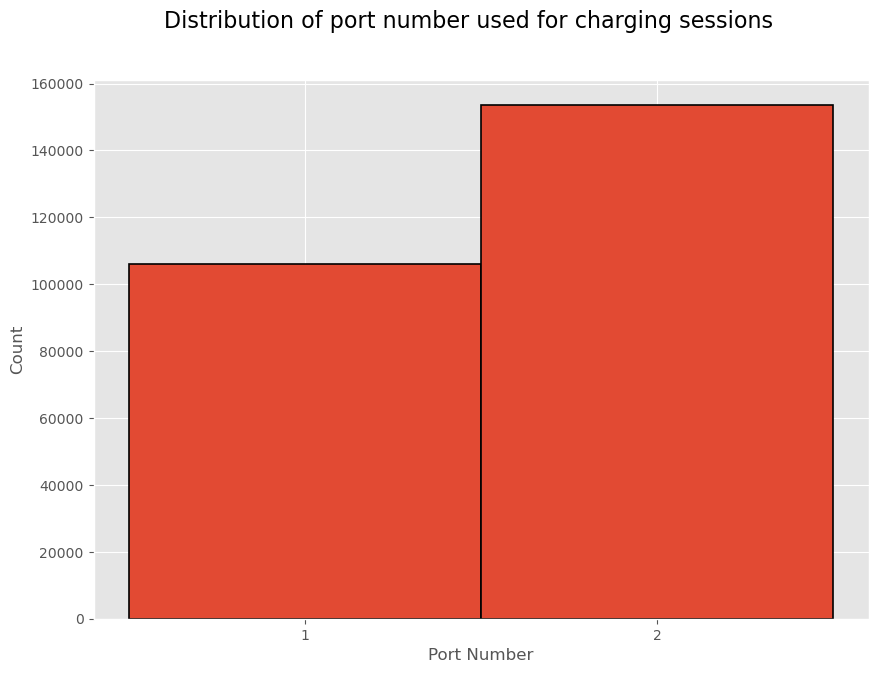

In [5]:
bins = np.arange(1, df['Port Number'].max() + 1.5) - 0.5
# then you plot away
fig, ax = plt.subplots(figsize=(10, 7))
fig.suptitle('Distribution of port number used for charging sessions', fontsize=16)

_ = ax.hist(df['Port Number'], bins, edgecolor='k', linewidth=1.2)
ax.set_xticks(bins + 0.5)
ax.set_xlabel('Port Number')
ax.set_ylabel('Count')
plt.plot()

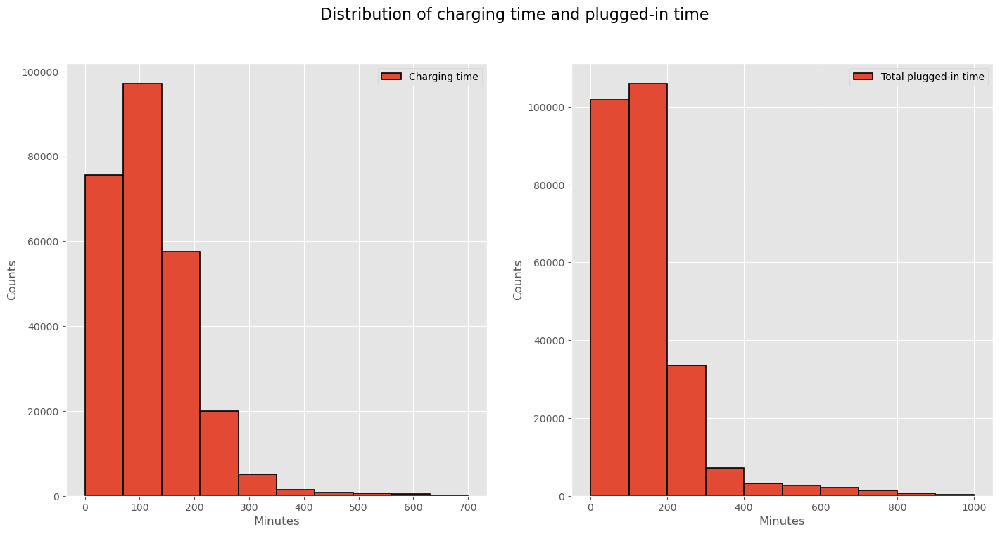

In [6]:
# Histogram of charging and total plugged in time
fig, ax = plt.subplots(1,2, figsize=(17, 8))
fig.suptitle('Distribution of charging time and plugged-in time', fontsize=16)
# Filter out extreme values
df_his = df[(df['Charging Time (min)'] < 700) & (df['Total Duration (min)'] < 1000)]

ax[0].hist(df_his['Charging Time (min)'], label="Charging time", edgecolor='k', linewidth=1.2)
ax[1].hist(df_his['Total Duration (min)'], label="Total plugged-in time", edgecolor='k', linewidth=1.2)

for i in range(len(ax)):
    ax[i].set_xlabel('Minutes')
    ax[i].set_ylabel('Counts')
    ax[i].legend()

plt.show()

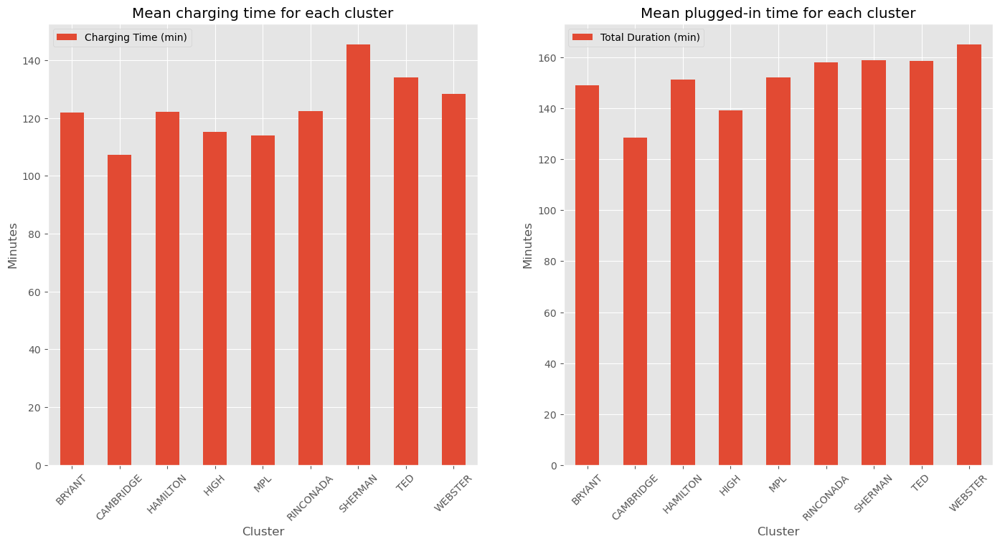

In [7]:
fig, ax = plt.subplots(1,2, figsize=(17, 8))
df.groupby(['Cluster'])['Charging Time (min)'].mean().plot(ax=ax[0], kind='bar',  title='Mean charging time for each cluster', rot=45)
df.groupby(['Cluster'])['Total Duration (min)'].mean().plot(ax=ax[1], kind='bar', title='Mean plugged-in time for each cluster', rot=45)
for i in range(len(ax)):
    ax[i].set_ylabel('Minutes')
    ax[i].legend()

plt.show()

## Create count-process 

In [8]:
INTERVAL_LENGTH = 30 # minutes
df_combined = create_count_data(df, INTERVAL_LENGTH, save=True)
df_combined.head()

,Period,Sessions,Cluster
0,2011-07-29 20:00:00,1,HAMILTON
1,2011-07-29 20:30:00,1,HAMILTON
2,2011-07-29 21:00:00,1,HAMILTON
3,2011-07-29 21:30:00,1,HAMILTON
4,2011-07-29 22:00:00,1,HAMILTON


In [9]:
df_combined[df_combined.Cluster == 'BRYANT'].head()

,Period,Sessions,Cluster
326835,2011-10-10 15:00:00,1,BRYANT
326836,2011-10-10 15:30:00,0,BRYANT
326837,2011-10-10 16:00:00,0,BRYANT
326838,2011-10-10 16:30:00,0,BRYANT
326839,2011-10-10 17:00:00,0,BRYANT


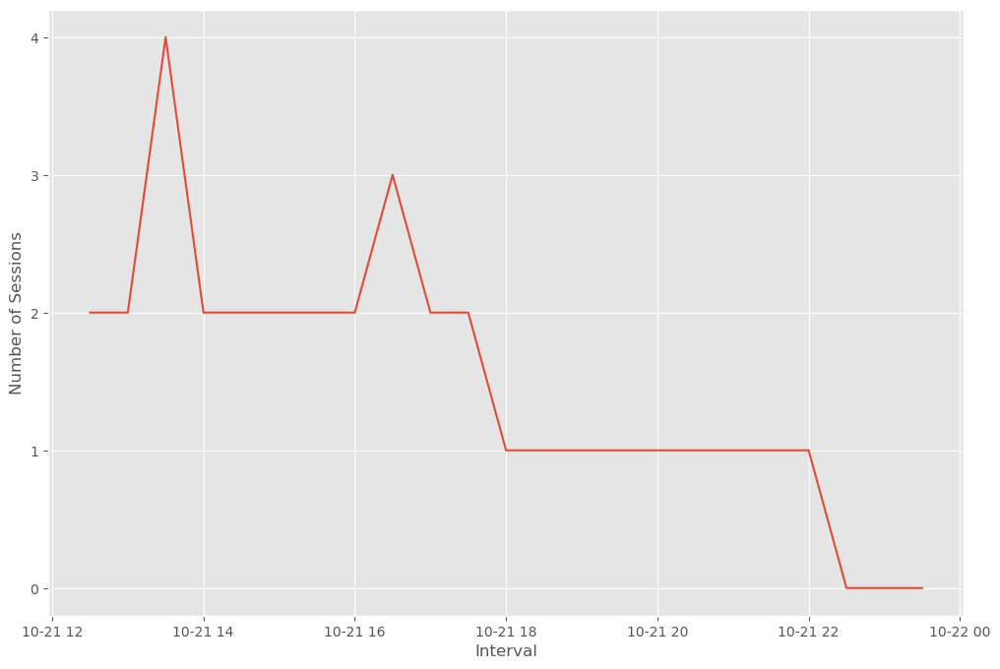

In [10]:
fig, ax = plt.subplots(figsize=(12, 8))
CLUSTER = 'BRYANT'
START = '2011-10-21 12:00'
END = '2011-10-22'

boi = df_combined[df_combined.Cluster == CLUSTER].loc[(df_combined[df_combined.Cluster == CLUSTER].Period > START) & (df_combined[df_combined.Cluster == CLUSTER].Period < END)]
ax.plot(boi.Period, boi.Sessions)
# Make y-axis integral
ax.yaxis.set_major_locator(MaxNLocator(integer=True))
ax.set_xlabel('Interval')
ax.set_ylabel('Number of Sessions')
plt.show()

In [11]:
df[df.Cluster == CLUSTER].loc[(df[df.Cluster == CLUSTER]['End Date'] > '2011-10-21 12:30') & (df[df.Cluster == CLUSTER]['Start Date'] < '2011-10-22 12:00')]

,Station Name,MAC Address,Start Date,End Date,Energy (kWh),Port Type,Port Number,Plug Type,Latitude,Longitude,Fee,Plug In Event Id,Id,Total Duration (min),Charging Time (min),Cluster,Period
500,PALO ALTO CA / BRYANT #2,000D6F0000A2108E,2011-10-21 09:16:00,2011-10-21 13:45:00,4.950762,Level 2,2,J1772,37.446373,-122.162331,0.0,30,500,269.150000,102.400000,BRYANT,"DatetimeIndex(['2011-10-21 09:16:00', '2011-10..."
503,PALO ALTO CA / BRYANT #1,000D6F0000A20D9E,2011-10-21 12:41:00,2011-10-21 13:45:00,5.135938,Level 2,2,J1772,37.446373,-122.162331,0.0,21,503,63.850000,63.733333,BRYANT,"DatetimeIndex(['2011-10-21 12:41:00', '2011-10..."
504,PALO ALTO CA / BRYANT #1,000D6F0000A20D9E,2011-10-21 13:46:00,2011-10-21 16:58:00,6.453933,Level 2,2,J1772,37.446373,-122.162331,0.0,23,504,191.600000,109.216667,BRYANT,"DatetimeIndex(['2011-10-21 13:46:00', '2011-10..."
505,PALO ALTO CA / BRYANT #2,000D6F0000A2108E,2011-10-21 13:55:00,2011-10-21 17:43:00,13.922402,Level 2,2,J1772,37.446373,-122.162331,0.0,32,505,227.750000,227.616667,BRYANT,"DatetimeIndex(['2011-10-21 13:55:00', '2011-10..."
508,PALO ALTO CA / BRYANT #1,000D6F0000A20D9E,2011-10-21 16:59:00,2011-10-21 22:20:00,14.575480,Level 2,2,J1772,37.446373,-122.162331,0.0,24,508,320.966667,237.716667,BRYANT,"DatetimeIndex(['2011-10-21 16:59:00', '2011-10..."


In [12]:
df[df.Cluster == 'HAMILTON'].sort_values(by='Start Date', ascending=False).head(10)

,Station Name,MAC Address,Start Date,End Date,Energy (kWh),Port Type,Port Number,Plug Type,Latitude,Longitude,Fee,Plug In Event Id,Id,Total Duration (min),Charging Time (min),Cluster,Period
257337,PALO ALTO CA / HAMILTON #2,0024:B100:0002:965D,2020-11-04 04:54:00,2020-11-04 06:50:00,5.221,Level 2,2,J1772,37.444706,-122.160324,1.20,9419,257337,116.783333,113.166667,HAMILTON,"DatetimeIndex(['2020-11-04 04:54:00', '2020-11..."
257335,PALO ALTO CA / HAMILTON #1,000D:6F00:015A:9D76,2020-11-03 18:03:00,2020-11-20 03:11:00,16.590,Level 2,2,J1772,37.444489,-122.160370,3.82,17366,257335,340.200000,322.383333,HAMILTON,"DatetimeIndex(['2020-11-03 18:03:00', '2020-11..."
257332,PALO ALTO CA / HAMILTON #2,0024:B100:0002:965D,2020-11-03 17:29:00,2020-11-03 19:07:00,5.562,Level 2,1,J1772,37.444706,-122.160324,1.28,9418,257332,98.333333,98.033333,HAMILTON,"DatetimeIndex(['2020-11-03 17:29:00', '2020-11..."
257330,PALO ALTO CA / HAMILTON #2,0024:B100:0002:965D,2020-11-03 16:45:00,2020-11-03 21:43:00,15.403,Level 2,2,J1772,37.444706,-122.160324,3.54,9417,257330,298.033333,297.850000,HAMILTON,"DatetimeIndex(['2020-11-03 16:45:00', '2020-11..."
257322,PALO ALTO CA / HAMILTON #1,000D:6F00:015A:9D76,2020-11-03 13:59:00,2020-11-03 14:58:00,5.508,Level 2,2,J1772,37.444489,-122.160370,1.27,17364,257322,58.600000,58.500000,HAMILTON,"DatetimeIndex(['2020-11-03 13:59:00', '2020-11..."
257297,PALO ALTO CA / HAMILTON #1,000D:6F00:015A:9D76,2020-11-03 08:48:00,2020-11-03 11:40:00,6.545,Level 2,2,J1772,37.444489,-122.160370,1.51,17363,257297,171.366667,131.916667,HAMILTON,"DatetimeIndex(['2020-11-03 08:48:00', '2020-11..."
257294,PALO ALTO CA / HAMILTON #2,0024:B100:0002:965D,2020-11-03 07:42:00,2020-11-03 16:17:00,47.757,Level 2,1,J1772,37.444706,-122.160324,10.98,9416,257294,514.850000,514.566667,HAMILTON,"DatetimeIndex(['2020-11-03 07:42:00', '2020-11..."
257290,PALO ALTO CA / HAMILTON #2,0024:B100:0002:965D,2020-11-03 05:00:00,2020-11-03 07:02:00,4.948,Level 2,1,J1772,37.444706,-122.160324,1.14,9415,257290,122.700000,107.766667,HAMILTON,"DatetimeIndex(['2020-11-03 05:00:00', '2020-11..."
257286,PALO ALTO CA / HAMILTON #2,0024:B100:0002:965D,2020-11-02 16:14:00,2020-11-02 21:58:00,32.128,Level 2,1,J1772,37.444706,-122.160324,7.39,9414,257286,343.833333,343.500000,HAMILTON,"DatetimeIndex(['2020-11-02 16:14:00', '2020-11..."
257262,PALO ALTO CA / HAMILTON #2,0024:B100:0002:965D,2020-11-02 04:42:00,2020-11-02 06:44:00,4.873,Level 2,1,J1772,37.444706,-122.160324,1.12,9413,257262,121.533333,106.466667,HAMILTON,"DatetimeIndex(['2020-11-02 04:42:00', '2020-11..."


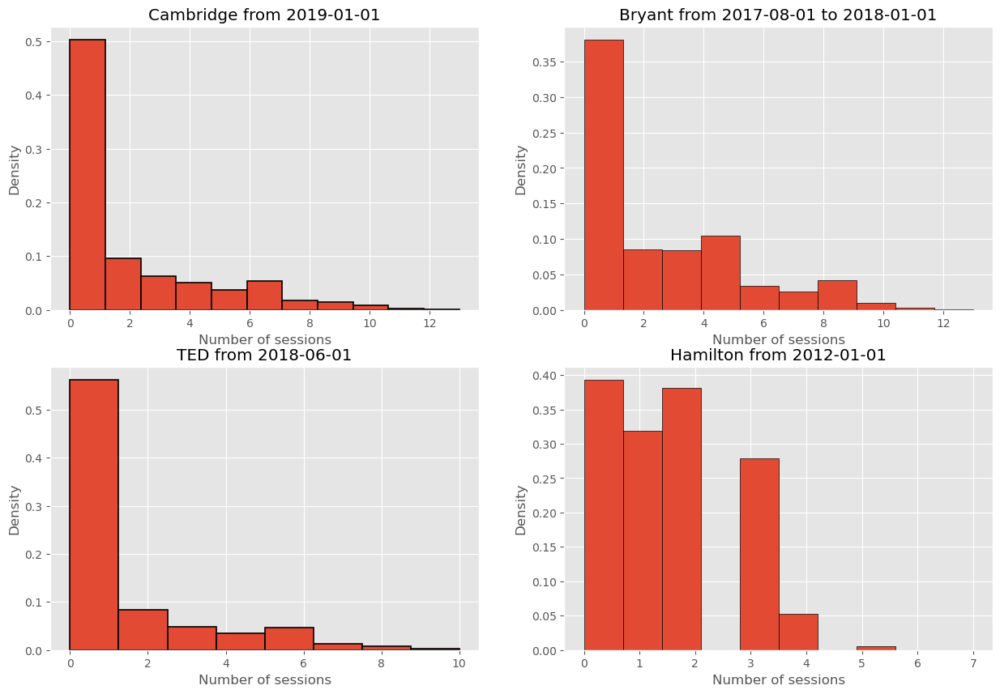

In [13]:
fig, axs = plt.subplots(2, 2, figsize=(15, 10))
df_combined[(df_combined.Cluster == 'CAMBRIDGE') & (df_combined.Period > '2019-01-01')].Sessions.hist(density=True, bins=11, edgecolor='k', linewidth=1.2, ax=axs[0,0])
axs[0,0].set_title('Cambridge from 2019-01-01')

df_combined[(df_combined.Cluster == 'BRYANT') & (df_combined.Period > '2017-06-01') & (df_combined.Period <= '2018-01-01')].Sessions.hist(density=True, edgecolor='k', ax=axs[0,1])
axs[0,1].set_title('Bryant from 2017-08-01 to 2018-01-01')

df_combined[(df_combined.Cluster == 'TED') & (df_combined.Period > '2018-06-01')].Sessions.hist(density=True, bins=8, edgecolor='k', linewidth=1.2, ax=axs[1,0])
axs[1,0].set_title('TED from 2018-06-01')

df_combined[(df_combined.Cluster == 'HAMILTON') & (df_combined.Period > '2012-01-01')].Sessions.hist(density=True, edgecolor='k', ax=axs[1,1])
axs[1,1].set_title('Hamilton from 2012-01-01')

for i in range(2):
    for j in range(2):
        axs[i,j].set_xlabel('Number of sessions')
        axs[i,j].set_ylabel('Density')



In [14]:
df_combined[(df_combined.Cluster == 'CAMBRIDGE') & (df_combined.Period > '2019-01-01')].Sessions.value_counts()

0     13257
1      7570
2      3953
3      2600
4      2102
5      1518
6      1176
7      1037
8       759
9       587
10      362
11      113
12       37
13        7
Name: Sessions, dtype: int64

In [15]:
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio

plot_template = dict(
    layout=go.Layout({
        "font_size": 18,
        "xaxis_title_font_size": 24,
        "yaxis_title_font_size": 24})
)

fig = px.line(df_combined[df_combined.Cluster == 'HAMILTON'], x='Period', y='Sessions', color='Cluster', title='Number of sessions per cluster')
fig.update_layout(
    template=plot_template, legend=dict(orientation='h', y=1.02, title_text="")
)
fig.show()